In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from glob import glob
import os
from skimage.io import imread
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
dsb_data_dir = os.path.join('..', 'input')
stage_label = 'stage1'

In [2]:
train_labels = pd.read_csv(os.path.join(dsb_data_dir,'{}_train_labels.csv'.format(stage_label)))

In [3]:
train_labels

,ImageId,EncodedPixels
0,00071198d059ba7f5914a526d124d28e6d010c92466da2...,6908 1 7161 8 7417 8 7672 9 7928 9 8184 9 8440...
1,00071198d059ba7f5914a526d124d28e6d010c92466da2...,36269 7 36523 11 36778 13 37033 15 37288 17 37...
2,00071198d059ba7f5914a526d124d28e6d010c92466da2...,19919 6 20174 8 20429 10 20685 11 20941 12 211...
3,00071198d059ba7f5914a526d124d28e6d010c92466da2...,18671 6 18926 8 19181 9 19436 10 19691 11 1994...
4,00071198d059ba7f5914a526d124d28e6d010c92466da2...,40158 3 40413 5 40669 5 40925 5 41182 3
5,00071198d059ba7f5914a526d124d28e6d010c92466da2...,58535 6 58791 10 59047 12 59303 16 59553 2 595...
6,00071198d059ba7f5914a526d124d28e6d010c92466da2...,31989 7 32244 12 32499 14 32754 15 33009 16 33...
7,00071198d059ba7f5914a526d124d28e6d010c92466da2...,11966 4 12220 9 12473 14 12729 15 12984 16 132...
8,00071198d059ba7f5914a526d124d28e6d010c92466da2...,58148 3 58403 5 58657 10 58912 13 59167 15 594...
9,00071198d059ba7f5914a526d124d28e6d010c92466da2...,14825 3 15080 5 15336 5 15592 5 15849 3


In [4]:
train_labels['EncodedPixels'] = train_labels['EncodedPixels'].map(lambda ep: [int(x) for x in ep.split(' ')])

In [5]:
train_labels

,ImageId,EncodedPixels
0,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[6908, 1, 7161, 8, 7417, 8, 7672, 9, 7928, 9, ..."
1,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[36269, 7, 36523, 11, 36778, 13, 37033, 15, 37..."
2,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[19919, 6, 20174, 8, 20429, 10, 20685, 11, 209..."
3,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[18671, 6, 18926, 8, 19181, 9, 19436, 10, 1969..."
4,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[40158, 3, 40413, 5, 40669, 5, 40925, 5, 41182..."
5,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[58535, 6, 58791, 10, 59047, 12, 59303, 16, 59..."
6,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[31989, 7, 32244, 12, 32499, 14, 32754, 15, 33..."
7,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[11966, 4, 12220, 9, 12473, 14, 12729, 15, 129..."
8,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[58148, 3, 58403, 5, 58657, 10, 58912, 13, 591..."
9,00071198d059ba7f5914a526d124d28e6d010c92466da2...,"[14825, 3, 15080, 5, 15336, 5, 15592, 5, 15849..."


In [6]:
all_images = glob(os.path.join(dsb_data_dir, 'stage1_*', '*', '*', '*'))
img_df = pd.DataFrame({'path': all_images})
img_id = lambda in_path: in_path.split('/')[-3]
img_type = lambda in_path: in_path.split('/')[-2]
img_group = lambda in_path: in_path.split('/')[-4].split('_')[1]
img_stage = lambda in_path: in_path.split('/')[-4].split('_')[0]
img_df['ImageId'] = img_df['path'].map(img_id)
img_df['ImageType'] = img_df['path'].map(img_type)
img_df['TrainingSplit'] = img_df['path'].map(img_group)
img_df['Stage'] = img_df['path'].map(img_stage)
img_df.sample(2)

,path,ImageId,ImageType,TrainingSplit,Stage
20825,../input/stage1_train/6fe2df6de1d962b90146c822...,6fe2df6de1d962b90146c822bcefc84d0d3d6926fdfbac...,masks,train,stage1
1198,../input/stage1_train/1815cf307859b3e13669041d...,1815cf307859b3e13669041d181aa3b3dbbac1a95aef4c...,masks,train,stage1


In [7]:
%%time
train_df = img_df.query('TrainingSplit=="train"')
train_rows = []
group_cols = ['Stage', 'ImageId']
for n_group, n_rows in train_df.groupby(group_cols):
    c_row = {col_name: col_value for col_name, col_value in zip(group_cols, n_group)}
    c_row['masks'] = n_rows.query('ImageType == "masks"')['path'].values.tolist()
    c_row['images'] = n_rows.query('ImageType == "images"')['path'].values.tolist()
    train_rows += [c_row]
train_img_df = pd.DataFrame(train_rows)    
IMG_CHANNELS = 3
def read_and_stack(in_img_list):
    return np.sum(np.stack([imread(c_img) for c_img in in_img_list], 0), 0)/255.0
train_img_df['images'] = train_img_df['images'].map(read_and_stack).map(lambda x: x[:,:,:IMG_CHANNELS])
train_img_df['masks'] = train_img_df['masks'].map(read_and_stack).map(lambda x: x.astype(int))
#train_img_df.sample(1)

CPU times: user 28.1 s, sys: 1.39 s, total: 29.4 s
Wall time: 29.5 s


In [8]:
train_img_df.sample(1)

,ImageId,Stage,images,masks
375,8efed2e62c919e6d70a2ab548b1a33014877fe8a23f177...,stage1,"[[[0.211764705882, 0.211764705882, 0.211764705...","[[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0,..."


In [32]:
def simple_gen():
    while True:
        for _, c_row in train_img_df.iterrows():
            yield np.expand_dims(c_row['images'],0), np.expand_dims(np.expand_dims(c_row['masks'],-1),0)
simple_gen()

<generator object simple_gen at 0x7f6f4f32d460>

In [43]:
for i in simple_gen():
    print(i)

(array([[[[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.01176471,  0.01176471

(array([[[[ 0.69803922,  0.59607843,  0.77254902],
         [ 0.69019608,  0.59607843,  0.78431373],
         [ 0.69019608,  0.60392157,  0.79607843],
         ..., 
         [ 0.68235294,  0.61176471,  0.78823529],
         [ 0.68627451,  0.61568627,  0.78823529],
         [ 0.68627451,  0.60784314,  0.79215686]],

        [[ 0.69411765,  0.61176471,  0.76862745],
         [ 0.68627451,  0.60784314,  0.77254902],
         [ 0.68627451,  0.60784314,  0.78823529],
         ..., 
         [ 0.68627451,  0.60784314,  0.79215686],
         [ 0.68627451,  0.61176471,  0.78823529],
         [ 0.68235294,  0.60392157,  0.79215686]],

        [[ 0.70196078,  0.62352941,  0.76862745],
         [ 0.68627451,  0.61568627,  0.77254902],
         [ 0.68235294,  0.61568627,  0.78431373],
         ..., 
         [ 0.68235294,  0.59607843,  0.79215686],
         [ 0.68627451,  0.60392157,  0.78823529],
         [ 0.69019608,  0.6       ,  0.78823529]],

        ..., 
        [[ 0.69411765,  0.6       

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.27058824,  0.27058824,  0.27058824],
         [ 0.23529412,  0.23529412,  0.23529412],
         [ 0.21568627,  0.21568627,  0.21568627],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.25098039,  0.25098039,  0.25098039],
         [ 0.23529412,  0.23529412,  0.23529412],
         [ 0.22352941,  0.22352941,  0.22352941],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.24313725,  0.24313725,  0.24313725],
         [ 0.21960784,  0.21960784,  0.21960784],
         [ 0.21176471,  0.21176471,  0.21176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01176471,  0.01176471

(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        ..., 
        [[ 0.13333333,  0.13333333

(array([[[[ 0.69411765,  0.60392157,  0.80784314],
         [ 0.69411765,  0.60784314,  0.80392157],
         [ 0.69019608,  0.60784314,  0.80784314],
         ..., 
         [ 0.69411765,  0.63921569,  0.81568627],
         [ 0.67843137,  0.61960784,  0.81176471],
         [ 0.6627451 ,  0.60392157,  0.80392157]],

        [[ 0.69803922,  0.61176471,  0.80784314],
         [ 0.69411765,  0.61176471,  0.80784314],
         [ 0.69411765,  0.61176471,  0.80784314],
         ..., 
         [ 0.69019608,  0.63529412,  0.81176471],
         [ 0.6745098 ,  0.61568627,  0.80392157],
         [ 0.65882353,  0.59607843,  0.79607843]],

        [[ 0.70196078,  0.61176471,  0.81176471],
         [ 0.70196078,  0.61568627,  0.81176471],
         [ 0.69411765,  0.61568627,  0.80784314],
         ..., 
         [ 0.68627451,  0.62745098,  0.80784314],
         [ 0.6745098 ,  0.61176471,  0.8       ],
         [ 0.6627451 ,  0.59607843,  0.79607843]],

        ..., 
        [[ 0.46666667,  0.23137255

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.01176471,  0.01176471

(array([[[[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.01176471,  0.01176471

(array([[[[ 0.68235294,  0.58039216,  0.78431373],
         [ 0.69019608,  0.60392157,  0.79215686],
         [ 0.69019608,  0.61960784,  0.79215686],
         ..., 
         [ 0.71764706,  0.63921569,  0.79607843],
         [ 0.72156863,  0.64313725,  0.80392157],
         [ 0.72156863,  0.64705882,  0.80392157]],

        [[ 0.69411765,  0.60392157,  0.8       ],
         [ 0.69803922,  0.62745098,  0.8       ],
         [ 0.70196078,  0.64313725,  0.78823529],
         ..., 
         [ 0.71764706,  0.63921569,  0.79215686],
         [ 0.71764706,  0.64313725,  0.79607843],
         [ 0.71764706,  0.65098039,  0.79607843]],

        [[ 0.70196078,  0.62352941,  0.80392157],
         [ 0.70588235,  0.64705882,  0.80784314],
         [ 0.70588235,  0.65490196,  0.79215686],
         ..., 
         [ 0.71372549,  0.63921569,  0.79215686],
         [ 0.71372549,  0.64313725,  0.79215686],
         [ 0.71372549,  0.64705882,  0.78823529]],

        ..., 
        [[ 0.69411765,  0.60392157

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196]],

        ..., 
        [[ 0.06666667,  0.06666667

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.10980392,  0.10980392,  0.10980392],
         [ 0.06666667,  0.06666667,  0.06666667]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.08235294,  0.08235294,  0.08235294],
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.07058824,  0.07058824,  0.07058824]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.08235294,  0.08235294,  0.08235294]],

        ..., 
        [[ 0.04313725,  0.04313725

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.06666667,  0.06666667,  0.06666667],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882]],

        ..., 
        [[ 0.21568627,  0.21568627

(array([[[[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.11372549,  0.11372549,  0.11372549],
         [ 0.14901961,  0.14901961,  0.14901961],
         [ 0.17647059,  0.17647059,  0.17647059]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.06666667,  0.06666667,  0.06666667],
         [ 0.0745098 ,  0.0745098 ,  0.0745098 ],
         [ 0.08627451,  0.08627451,  0.08627451]],

        [[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.11372549,  0.11372549,  0.11372549],
         [ 0.12156863,  0.12156863,  0.12156863],
         [ 0.11372549,  0.11372549,  0.11372549]],

        [[ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         ..., 
         [ 0.11764706,  0.11764706,  0.11764706],
         [ 0.10980392,  0.10980392,  0.10980392],
         [ 0.12156863,  0.12156863,  0.12156863]],

        [[ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.06666667,  0.06666667,  0.06666667],
         ..., 
         [ 0.12156863,  0.12156863,  0.12156863],
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ],
         [ 0.12156863,  0.12156863,  0.12156863]],

        ..., 
        [[ 0.12156863,  0.12156863

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.20392157,  0.20392157,  0.20392157],
         [ 0.21176471,  0.21176471,  0.21176471],
         [ 0.24705882,  0.24705882,  0.24705882]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.18039216,  0.18039216,  0.18039216],
         [ 0.20784314,  0.20784314,  0.20784314],
         [ 0.24313725,  0.24313725,  0.24313725]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.16862745,  0.16862745,  0.16862745],
         [ 0.20392157,  0.20392157,  0.20392157],
         [ 0.23921569,  0.23921569,  0.23921569]],

        ..., 
        [[ 0.08627451,  0.08627451

(array([[[[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.02352941,  0.02352941

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.0627451 ,  0.0627451 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.69019608,  0.62745098,  0.80392157],
         [ 0.69019608,  0.62745098,  0.80392157],
         [ 0.69411765,  0.61960784,  0.81176471],
         ..., 
         [ 0.71372549,  0.62745098,  0.82352941],
         [ 0.71372549,  0.62745098,  0.82745098],
         [ 0.70588235,  0.63137255,  0.82352941]],

        [[ 0.69411765,  0.61960784,  0.80784314],
         [ 0.69411765,  0.62352941,  0.81176471],
         [ 0.69411765,  0.61960784,  0.81568627],
         ..., 
         [ 0.71764706,  0.62745098,  0.82352941],
         [ 0.71372549,  0.62745098,  0.81960784],
         [ 0.70588235,  0.63137255,  0.81960784]],

        [[ 0.69411765,  0.60392157,  0.81176471],
         [ 0.68627451,  0.60784314,  0.81176471],
         [ 0.68235294,  0.61176471,  0.81176471],
         ..., 
         [ 0.71764706,  0.62745098,  0.81960784],
         [ 0.71372549,  0.63137255,  0.81960784],
         [ 0.70196078,  0.63137255,  0.81568627]],

        ..., 
        [[ 0.69803922,  0.61960784

(array([[[[ 0.90196078,  0.90196078,  0.90196078],
         [ 0.88235294,  0.88235294,  0.88235294],
         [ 0.88627451,  0.88627451,  0.88627451],
         ..., 
         [ 0.91372549,  0.91372549,  0.91372549],
         [ 0.89411765,  0.89411765,  0.89411765],
         [ 0.89411765,  0.89411765,  0.89411765]],

        [[ 0.90980392,  0.90980392,  0.90980392],
         [ 0.89019608,  0.89019608,  0.89019608],
         [ 0.8627451 ,  0.8627451 ,  0.8627451 ],
         ..., 
         [ 0.90980392,  0.90980392,  0.90980392],
         [ 0.88627451,  0.88627451,  0.88627451],
         [ 0.87058824,  0.87058824,  0.87058824]],

        [[ 0.8745098 ,  0.8745098 ,  0.8745098 ],
         [ 0.87843137,  0.87843137,  0.87843137],
         [ 0.89411765,  0.89411765,  0.89411765],
         ..., 
         [ 0.89803922,  0.89803922,  0.89803922],
         [ 0.92156863,  0.92156863,  0.92156863],
         [ 0.90980392,  0.90980392,  0.90980392]],

        ..., 
        [[ 0.69411765,  0.69411765

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882]],

        ..., 
        [[ 0.04705882,  0.04705882

(array([[[[ 0.75686275,  0.71372549,  0.76862745],
         [ 0.74117647,  0.70196078,  0.74117647],
         [ 0.73333333,  0.6745098 ,  0.71764706],
         ..., 
         [ 0.64313725,  0.69019608,  0.79607843],
         [ 0.60392157,  0.6627451 ,  0.8       ],
         [ 0.56862745,  0.61176471,  0.79215686]],

        [[ 0.72941176,  0.68627451,  0.7372549 ],
         [ 0.69803922,  0.67058824,  0.70980392],
         [ 0.69411765,  0.64313725,  0.67843137],
         ..., 
         [ 0.58823529,  0.59215686,  0.77254902],
         [ 0.52941176,  0.54509804,  0.76470588],
         [ 0.47843137,  0.4745098 ,  0.74901961]],

        [[ 0.72156863,  0.6627451 ,  0.70196078],
         [ 0.70196078,  0.65098039,  0.6627451 ],
         [ 0.68627451,  0.63921569,  0.61960784],
         ..., 
         [ 0.52941176,  0.45098039,  0.76470588],
         [ 0.49803922,  0.39607843,  0.72941176],
         [ 0.46666667,  0.32941176,  0.68627451]],

        ..., 
        [[ 0.8       ,  0.78823529

(array([[[[ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.50980392,  0.24313725,  0.64705882],
         [ 0.49411765,  0.21960784,  0.63529412],
         [ 0.4745098 ,  0.21568627,  0.63137255],
         ..., 
         [ 0.78431373,  0.76862745,  0.78039216],
         [ 0.77647059,  0.76470588,  0.80784314],
         [ 0.78431373,  0.76470588,  0.82745098]],

        [[ 0.50196078,  0.23921569,  0.6627451 ],
         [ 0.49803922,  0.22352941,  0.64313725],
         [ 0.49411765,  0.21568627,  0.63137255],
         ..., 
         [ 0.77647059,  0.77254902,  0.79215686],
         [ 0.78039216,  0.76470588,  0.8       ],
         [ 0.78823529,  0.76470588,  0.8       ]],

        [[ 0.52156863,  0.23921569,  0.66666667],
         [ 0.51372549,  0.22745098,  0.64705882],
         [ 0.50196078,  0.22352941,  0.63137255],
         ..., 
         [ 0.77647059,  0.77647059,  0.8       ],
         [ 0.77647059,  0.76470588,  0.79215686],
         [ 0.77647059,  0.77254902,  0.77647059]],

        ..., 
        [[ 0.76470588,  0.70980392

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.03529412,  0.03529412,  0.03529412],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.1254902 ,  0.1254902 

(array([[[[ 0.71372549,  0.61176471,  0.77254902],
         [ 0.71764706,  0.59607843,  0.77647059],
         [ 0.71372549,  0.59607843,  0.77647059],
         ..., 
         [ 0.5372549 ,  0.34117647,  0.6745098 ],
         [ 0.54117647,  0.28627451,  0.6627451 ],
         [ 0.53333333,  0.25882353,  0.64705882]],

        [[ 0.74509804,  0.6745098 ,  0.77647059],
         [ 0.7372549 ,  0.67058824,  0.78823529],
         [ 0.7372549 ,  0.6745098 ,  0.79215686],
         ..., 
         [ 0.56078431,  0.45490196,  0.70980392],
         [ 0.56470588,  0.38039216,  0.68627451],
         [ 0.55686275,  0.35294118,  0.68627451]],

        [[ 0.75686275,  0.7254902 ,  0.78823529],
         [ 0.76078431,  0.72941176,  0.8       ],
         [ 0.75686275,  0.73333333,  0.81568627],
         ..., 
         [ 0.5254902 ,  0.52156863,  0.76862745],
         [ 0.54509804,  0.45098039,  0.72941176],
         [ 0.54509804,  0.42352941,  0.74117647]],

        ..., 
        [[ 0.81960784,  0.84705882

(array([[[[ 0.71372549,  0.63921569,  0.79607843],
         [ 0.72156863,  0.63921569,  0.79607843],
         [ 0.7254902 ,  0.63921569,  0.8       ],
         ..., 
         [ 0.66666667,  0.54117647,  0.77254902],
         [ 0.64705882,  0.50196078,  0.77647059],
         [ 0.61960784,  0.49019608,  0.78039216]],

        [[ 0.71372549,  0.63921569,  0.79607843],
         [ 0.72156863,  0.64313725,  0.79607843],
         [ 0.7254902 ,  0.63921569,  0.80392157],
         ..., 
         [ 0.62745098,  0.46666667,  0.75294118],
         [ 0.58823529,  0.41568627,  0.74117647],
         [ 0.57254902,  0.40392157,  0.74901961]],

        [[ 0.71372549,  0.63921569,  0.79607843],
         [ 0.71764706,  0.64313725,  0.8       ],
         [ 0.7254902 ,  0.63921569,  0.80392157],
         ..., 
         [ 0.55294118,  0.38823529,  0.73333333],
         [ 0.54901961,  0.37647059,  0.74117647],
         [ 0.54901961,  0.36470588,  0.74509804]],

        ..., 
        [[ 0.72156863,  0.63137255

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.02745098,  0.02745098,  0.02745098]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03137255,  0.03137255,  0.03137255]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.03921569,  0.03921569,  0.03921569]],

        ..., 
        [[ 0.10196078,  0.10196078

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        ..., 
        [[ 0.00784314,  0.00784314

(array([[[[ 0.59215686,  0.59215686,  0.59215686],
         [ 0.56470588,  0.56470588,  0.56470588],
         [ 0.53333333,  0.53333333,  0.53333333],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.03921569,  0.03921569,  0.03921569]],

        [[ 0.58823529,  0.58823529,  0.58823529],
         [ 0.58039216,  0.58039216,  0.58039216],
         [ 0.5372549 ,  0.5372549 ,  0.5372549 ],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725]],

        [[ 0.59215686,  0.59215686,  0.59215686],
         [ 0.57647059,  0.57647059,  0.57647059],
         [ 0.52941176,  0.52941176,  0.52941176],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ]],

        ..., 
        [[ 0.05882353,  0.05882353

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.17254902,  0.17254902,  0.17254902],
         [ 0.16078431,  0.16078431,  0.16078431],
         [ 0.12156863,  0.12156863,  0.12156863]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.10588235,  0.10588235,  0.10588235],
         [ 0.09411765,  0.09411765,  0.09411765],
         [ 0.0745098 ,  0.0745098 ,  0.0745098 ]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.06666667,  0.06666667,  0.06666667],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05882353,  0.05882353,  0.05882353]],

        ..., 
        [[ 0.02745098,  0.02745098

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.02745098,  0.02745098,  0.02745098]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.03137255,  0.03137255,  0.03137255]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.03529412,  0.03529412,  0.03529412]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.03921569,  0.03921569,  0.03921569]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.03921569,  0.03921569,  0.03921569]],

        ..., 
        [[ 0.00784314,  0.00784314

(array([[[[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.06666667,  0.06666667,  0.06666667],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882]],

        ..., 
        [[ 0.22352941,  0.22352941

(array([[[[ 0.70196078,  0.62352941,  0.76470588],
         [ 0.71372549,  0.66666667,  0.78431373],
         [ 0.7254902 ,  0.70980392,  0.80392157],
         ..., 
         [ 0.79215686,  0.83921569,  0.84313725],
         [ 0.80784314,  0.83529412,  0.84705882],
         [ 0.81960784,  0.83137255,  0.84705882]],

        [[ 0.75686275,  0.69019608,  0.78431373],
         [ 0.74901961,  0.70588235,  0.79215686],
         [ 0.74117647,  0.72156863,  0.8       ],
         ..., 
         [ 0.80784314,  0.83921569,  0.85098039],
         [ 0.80784314,  0.83921569,  0.85490196],
         [ 0.80784314,  0.83529412,  0.86666667]],

        [[ 0.74509804,  0.7254902 ,  0.82352941],
         [ 0.74901961,  0.73333333,  0.80784314],
         [ 0.75294118,  0.74117647,  0.79215686],
         ..., 
         [ 0.80392157,  0.85098039,  0.8627451 ],
         [ 0.81176471,  0.84313725,  0.86666667],
         [ 0.82352941,  0.83529412,  0.88235294]],

        ..., 
        [[ 0.7254902 ,  0.78431373

(array([[[[ 0.11764706,  0.11764706,  0.11764706],
         [ 0.15294118,  0.15294118,  0.15294118],
         [ 0.20784314,  0.20784314,  0.20784314],
         ..., 
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.10196078,  0.10196078,  0.10196078],
         [ 0.11372549,  0.11372549,  0.11372549]],

        [[ 0.10196078,  0.10196078,  0.10196078],
         [ 0.1372549 ,  0.1372549 ,  0.1372549 ],
         [ 0.18039216,  0.18039216,  0.18039216],
         ..., 
         [ 0.09803922,  0.09803922,  0.09803922],
         [ 0.11764706,  0.11764706,  0.11764706],
         [ 0.13333333,  0.13333333,  0.13333333]],

        [[ 0.09411765,  0.09411765,  0.09411765],
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ],
         [ 0.14509804,  0.14509804,  0.14509804],
         ..., 
         [ 0.11764706,  0.11764706,  0.11764706],
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ],
         [ 0.14117647,  0.14117647,  0.14117647]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        ..., 
        [[ 0.01568627,  0.01568627

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.09411765,  0.09411765,  0.09411765],
         [ 0.09411765,  0.09411765,  0.09411765],
         [ 0.09411765,  0.09411765,  0.09411765]],

        [[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.09411765,  0.09411765,  0.09411765],
         [ 0.09411765,  0.09411765,  0.09411765],
         [ 0.09411765,  0.09411765,  0.09411765]],

        [[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.09019608,  0.09019608,  0.09019608],
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.09411765,  0.09411765,  0.09411765]],

        ..., 
        [[ 0.02745098,  0.02745098

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.03137255,  0.03137255,  0.03137255],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.04313725,  0.04313725,  0.04313725],
         ..., 
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ]],

        ..., 
        [[ 0.09411765,  0.09411765

(array([[[[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353]],

        ..., 
        [[ 0.05882353,  0.05882353

(array([[[[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03529412,  0.03529412,  0.03529412]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03529412,  0.03529412,  0.03529412]],

        [[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03529412,  0.03529412,  0.03529412]],

        ..., 
        [[ 0.02352941,  0.02352941

(array([[[[ 0.31764706,  0.31764706,  0.31764706],
         [ 0.3254902 ,  0.3254902 ,  0.3254902 ],
         [ 0.32156863,  0.32156863,  0.32156863],
         ..., 
         [ 0.90196078,  0.90196078,  0.90196078],
         [ 0.89803922,  0.89803922,  0.89803922],
         [ 0.90980392,  0.90980392,  0.90980392]],

        [[ 0.34901961,  0.34901961,  0.34901961],
         [ 0.36078431,  0.36078431,  0.36078431],
         [ 0.34117647,  0.34117647,  0.34117647],
         ..., 
         [ 0.90588235,  0.90588235,  0.90588235],
         [ 0.89803922,  0.89803922,  0.89803922],
         [ 0.89411765,  0.89411765,  0.89411765]],

        [[ 0.41176471,  0.41176471,  0.41176471],
         [ 0.4       ,  0.4       ,  0.4       ],
         [ 0.40392157,  0.40392157,  0.40392157],
         ..., 
         [ 0.90980392,  0.90980392,  0.90980392],
         [ 0.89411765,  0.89411765,  0.89411765],
         [ 0.88627451,  0.88627451,  0.88627451]],

        ..., 
        [[ 0.90196078,  0.90196078

(array([[[[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.03137255,  0.03137255,  0.03137255],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.01176471,  0.01176471

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.0745098 ,  0.0745098 ,  0.0745098 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.06666667,  0.06666667,  0.06666667],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        ..., 
        [[ 0.17647059,  0.17647059

(array([[[[ 0.07843137,  0.07843137,  0.07843137],
         [ 0.10588235,  0.10588235,  0.10588235],
         [ 0.1372549 ,  0.1372549 ,  0.1372549 ],
         ..., 
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0745098 ,  0.0745098 ,  0.0745098 ],
         ..., 
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.02745098,  0.02745098,  0.02745098]],

        [[ 0.03529412,  0.03529412,  0.03529412],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.37647059,  0.37647059,  0.37647059],
         [ 0.38431373,  0.38431373,  0.38431373],
         [ 0.35294118,  0.35294118,  0.35294118],
         ..., 
         [ 0.18823529,  0.18823529,  0.18823529],
         [ 0.2       ,  0.2       ,  0.2       ],
         [ 0.21960784,  0.21960784,  0.21960784]],

        [[ 0.37254902,  0.37254902,  0.37254902],
         [ 0.35686275,  0.35686275,  0.35686275],
         [ 0.34117647,  0.34117647,  0.34117647],
         ..., 
         [ 0.17647059,  0.17647059,  0.17647059],
         [ 0.19215686,  0.19215686,  0.19215686],
         [ 0.21568627,  0.21568627,  0.21568627]],

        [[ 0.34509804,  0.34509804,  0.34509804],
         [ 0.34117647,  0.34117647,  0.34117647],
         [ 0.31764706,  0.31764706,  0.31764706],
         ..., 
         [ 0.16862745,  0.16862745,  0.16862745],
         [ 0.18823529,  0.18823529,  0.18823529],
         [ 0.19607843,  0.19607843,  0.19607843]],

        ..., 
        [[ 0.25098039,  0.25098039

(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        ..., 
        [[ 0.18039216,  0.18039216

(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784]],

        ..., 
        [[ 0.02352941,  0.02352941

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04313725,  0.04313725,  0.04313725]],

        [[ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882]],

        ..., 
        [[ 0.04705882,  0.04705882

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.07058824,  0.07058824,  0.07058824],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.07843137,  0.07843137,  0.07843137],
         [ 0.08235294,  0.08235294,  0.08235294],
         [ 0.09019608,  0.09019608,  0.09019608],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.12156863,  0.12156863,  0.12156863],
         [ 0.10980392,  0.10980392,  0.10980392],
         [ 0.09803922,  0.09803922,  0.09803922],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.01176471,  0.01176471

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        ..., 
        [[ 0.01176471,  0.01176471

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.04705882,  0.04705882,  0.04705882]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157]],

        ..., 
        [[ 0.00784314,  0.00784314

(array([[[[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.65882353,  0.6       ,  0.8       ],
         [ 0.66666667,  0.60392157,  0.8       ],
         [ 0.66666667,  0.60784314,  0.79607843],
         ..., 
         [ 0.70588235,  0.63921569,  0.81960784],
         [ 0.70588235,  0.64313725,  0.81568627],
         [ 0.70588235,  0.64313725,  0.81960784]],

        [[ 0.6627451 ,  0.60392157,  0.80392157],
         [ 0.67058824,  0.60784314,  0.80392157],
         [ 0.67058824,  0.60784314,  0.80392157],
         ..., 
         [ 0.70588235,  0.63529412,  0.82352941],
         [ 0.70980392,  0.63921569,  0.82352941],
         [ 0.70196078,  0.63529412,  0.82352941]],

        [[ 0.68627451,  0.61176471,  0.80784314],
         [ 0.68627451,  0.61568627,  0.80784314],
         [ 0.68235294,  0.61176471,  0.81176471],
         ..., 
         [ 0.70980392,  0.63529412,  0.82745098],
         [ 0.70196078,  0.63137255,  0.82352941],
         [ 0.69411765,  0.62745098,  0.81960784]],

        ..., 
        [[ 0.70196078,  0.62745098

(array([[[[ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05882353,  0.05882353,  0.05882353]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.06666667,  0.06666667,  0.06666667],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.06666667,  0.06666667,  0.06666667]],

        ..., 
        [[ 0.0627451 ,  0.0627451 

(array([[[[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.28235294,  0.28235294,  0.28235294],
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ],
         [ 0.08235294,  0.08235294,  0.08235294]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.30588235,  0.30588235,  0.30588235],
         [ 0.15294118,  0.15294118,  0.15294118],
         [ 0.09019608,  0.09019608,  0.09019608]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.4       ,  0.4       ,  0.4       ],
         [ 0.18431373,  0.18431373,  0.18431373],
         [ 0.09411765,  0.09411765,  0.09411765]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.09411765,  0.09411765

(array([[[[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         [ 0.05490196,  0.05490196,  0.05490196]],

        ..., 
        [[ 0.04313725,  0.04313725

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01960784,  0.01960784,  0.01960784]],

        ..., 
        [[ 0.01568627,  0.01568627

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.67843137,  0.56470588,  0.60392157],
         [ 0.6745098 ,  0.50980392,  0.56862745],
         [ 0.65882353,  0.49019608,  0.58039216],
         ..., 
         [ 0.70980392,  0.61568627,  0.7372549 ],
         [ 0.71764706,  0.63921569,  0.75686275],
         [ 0.74117647,  0.64705882,  0.78039216]],

        [[ 0.71372549,  0.64705882,  0.62352941],
         [ 0.70588235,  0.58431373,  0.59607843],
         [ 0.68235294,  0.55686275,  0.61568627],
         ..., 
         [ 0.72941176,  0.60784314,  0.76862745],
         [ 0.72156863,  0.63529412,  0.76470588],
         [ 0.74901961,  0.65098039,  0.76078431]],

        [[ 0.7372549 ,  0.71764706,  0.65098039],
         [ 0.7254902 ,  0.67058824,  0.61960784],
         [ 0.70980392,  0.63529412,  0.64313725],
         ..., 
         [ 0.7254902 ,  0.61568627,  0.79607843],
         [ 0.72156863,  0.64313725,  0.76862745],
         [ 0.74117647,  0.65882353,  0.7372549 ]],

        ..., 
        [[ 0.69411765,  0.63529412

(array([[[[ 0.08627451,  0.08627451,  0.08627451],
         [ 0.09019608,  0.09019608,  0.09019608],
         [ 0.08627451,  0.08627451,  0.08627451],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.0745098 ,  0.0745098 ,  0.0745098 ],
         [ 0.0745098 ,  0.0745098 ,  0.0745098 ],
         [ 0.08235294,  0.08235294,  0.08235294],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.07843137,  0.07843137,  0.07843137],
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.07843137,  0.07843137,  0.07843137],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        ..., 
        [[ 0.10196078,  0.10196078

(array([[[[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941]],

        ..., 
        [[ 0.02352941,  0.02352941

(array([[[[ 0.30196078,  0.30196078,  0.30196078],
         [ 0.3254902 ,  0.3254902 ,  0.3254902 ],
         [ 0.3372549 ,  0.3372549 ,  0.3372549 ],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.25882353,  0.25882353,  0.25882353],
         [ 0.29411765,  0.29411765,  0.29411765],
         [ 0.31372549,  0.31372549,  0.31372549],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.19607843,  0.19607843,  0.19607843],
         [ 0.25490196,  0.25490196,  0.25490196],
         [ 0.27058824,  0.27058824,  0.27058824],
         ..., 
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.01176471,  0.01176471

(array([[[[ 0.70196078,  0.61568627,  0.81568627],
         [ 0.70980392,  0.61176471,  0.81568627],
         [ 0.70588235,  0.61568627,  0.81176471],
         ..., 
         [ 0.6627451 ,  0.6       ,  0.81568627],
         [ 0.65882353,  0.6       ,  0.81176471],
         [ 0.65882353,  0.60392157,  0.80784314]],

        [[ 0.70196078,  0.61176471,  0.81176471],
         [ 0.70588235,  0.61568627,  0.81176471],
         [ 0.70196078,  0.61568627,  0.81568627],
         ..., 
         [ 0.66666667,  0.6       ,  0.81568627],
         [ 0.6627451 ,  0.60392157,  0.80784314],
         [ 0.6627451 ,  0.60784314,  0.80784314]],

        [[ 0.69803922,  0.61176471,  0.81176471],
         [ 0.70196078,  0.61568627,  0.81176471],
         [ 0.70196078,  0.61176471,  0.81568627],
         ..., 
         [ 0.67058824,  0.60392157,  0.81176471],
         [ 0.67058824,  0.60784314,  0.80784314],
         [ 0.67058824,  0.61176471,  0.80784314]],

        ..., 
        [[ 0.67058824,  0.58823529

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.34509804,  0.34509804,  0.34509804],
         [ 0.34901961,  0.34901961,  0.34901961],
         [ 0.35686275,  0.35686275,  0.35686275]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.3372549 ,  0.3372549 ,  0.3372549 ],
         [ 0.3372549 ,  0.3372549 ,  0.3372549 ],
         [ 0.35294118,  0.35294118,  0.35294118]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.31372549,  0.31372549,  0.31372549],
         [ 0.3254902 ,  0.3254902 ,  0.3254902 ],
         [ 0.35294118,  0.35294118,  0.35294118]],

        ..., 
        [[ 0.36078431,  0.36078431

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.35294118,  0.35294118,  0.35294118],
         [ 0.34901961,  0.34901961,  0.34901961],
         [ 0.34901961,  0.34901961,  0.34901961]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.32941176,  0.32941176,  0.32941176],
         [ 0.3372549 ,  0.3372549 ,  0.3372549 ],
         [ 0.3254902 ,  0.3254902 ,  0.3254902 ]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.31372549,  0.31372549,  0.31372549],
         [ 0.31372549,  0.31372549,  0.31372549],
         [ 0.30980392,  0.30980392,  0.30980392]],

        ..., 
        [[ 0.02352941,  0.02352941

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01960784,  0.01960784,  0.01960784]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         ..., 
         [ 0.6       ,  0.6       ,  0.6       ],
         [ 0.50588235,  0.50588235,  0.50588235],
         [ 0.30980392,  0.30980392,  0.30980392]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.54509804,  0.54509804,  0.54509804],
         [ 0.58039216,  0.58039216,  0.58039216],
         [ 0.4627451 ,  0.4627451 ,  0.4627451 ]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.54117647,  0.54117647,  0.54117647],
         [ 0.56470588,  0.56470588,  0.56470588],
         [ 0.50588235,  0.50588235,  0.50588235]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03921569,  0.03921569,  0.03921569]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03529412,  0.03529412,  0.03529412]],

        [[ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         [ 0.00392157,  0.00392157,  0.00392157],
         ..., 
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255]],

        ..., 
        [[ 0.00392157,  0.00392157

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.25490196,  0.25490196,  0.25490196],
         [ 0.26666667,  0.26666667,  0.26666667],
         [ 0.27843137,  0.27843137,  0.27843137]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.2745098 ,  0.2745098 ,  0.2745098 ],
         [ 0.28235294,  0.28235294,  0.28235294],
         [ 0.29803922,  0.29803922,  0.29803922]],

        [[ 0.05882353,  0.05882353,  0.05882353],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.28235294,  0.28235294,  0.28235294],
         [ 0.29019608,  0.29019608,  0.29019608],
         [ 0.31372549,  0.31372549,  0.31372549]],

        ..., 
        [[ 0.04705882,  0.04705882

(array([[[[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.03529412,  0.03529412,  0.03529412],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03921569,  0.03921569,  0.03921569],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.04705882,  0.04705882

(array([[[[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.11764706,  0.11764706,  0.11764706],
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ],
         [ 0.11764706,  0.11764706,  0.11764706]],

        [[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.12156863,  0.12156863,  0.12156863],
         [ 0.12941176,  0.12941176,  0.12941176],
         [ 0.12156863,  0.12156863,  0.12156863]],

        [[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02745098,  0.02745098,  0.02745098],
         ..., 
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ],
         [ 0.12941176,  0.12941176,  0.12941176],
         [ 0.1254902 ,  0.1254902 ,  0.1254902 ]],

        ..., 
        [[ 0.03137255,  0.03137255

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.10980392,  0.10980392,  0.10980392],
         [ 0.06666667,  0.06666667,  0.06666667]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.08235294,  0.08235294,  0.08235294],
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.07058824,  0.07058824,  0.07058824]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.03137255,  0.03137255,  0.03137255],
         [ 0.01960784,  0.01960784,  0.01960784],
         ..., 
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.08235294,  0.08235294,  0.08235294]],

        ..., 
        [[ 0.04313725,  0.04313725

(array([[[[ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.03137255,  0.03137255,  0.03137255],
         ..., 
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.01960784,  0.01960784,  0.01960784],
         [ 0.02352941,  0.02352941,  0.02352941]],

        [[ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         ..., 
         [ 0.02745098,  0.02745098,  0.02745098],
         [ 0.02352941,  0.02352941,  0.02352941],
         [ 0.02352941,  0.02352941,  0.02352941]],

        ..., 
        [[ 0.01568627,  0.01568627

(array([[[[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05882353,  0.05882353,  0.05882353],
         [ 0.0627451 ,  0.0627451 ,  0.0627451 ],
         ..., 
         [ 0.6       ,  0.6       ,  0.6       ],
         [ 0.50588235,  0.50588235,  0.50588235],
         [ 0.30980392,  0.30980392,  0.30980392]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.54509804,  0.54509804,  0.54509804],
         [ 0.58039216,  0.58039216,  0.58039216],
         [ 0.4627451 ,  0.4627451 ,  0.4627451 ]],

        [[ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.54117647,  0.54117647,  0.54117647],
         [ 0.56470588,  0.56470588,  0.56470588],
         [ 0.50588235,  0.50588235,  0.50588235]],

        ..., 
        [[ 0.05098039,  0.05098039

(array([[[[ 0.86666667,  0.83921569,  0.86666667],
         [ 0.8627451 ,  0.82352941,  0.84313725],
         [ 0.84705882,  0.81176471,  0.82352941],
         ..., 
         [ 0.81568627,  0.85098039,  0.83137255],
         [ 0.82745098,  0.8627451 ,  0.86666667],
         [ 0.84313725,  0.8745098 ,  0.87843137]],

        [[ 0.8745098 ,  0.84313725,  0.86666667],
         [ 0.87058824,  0.82745098,  0.84313725],
         [ 0.85882353,  0.81960784,  0.81568627],
         ..., 
         [ 0.81176471,  0.8627451 ,  0.83529412],
         [ 0.82745098,  0.87058824,  0.87058824],
         [ 0.84313725,  0.88627451,  0.8745098 ]],

        [[ 0.86666667,  0.84705882,  0.8745098 ],
         [ 0.86666667,  0.82745098,  0.84705882],
         [ 0.84705882,  0.82352941,  0.81176471],
         ..., 
         [ 0.81176471,  0.86666667,  0.83921569],
         [ 0.82352941,  0.87843137,  0.8745098 ],
         [ 0.84313725,  0.88627451,  0.8745098 ]],

        ..., 
        [[ 0.84313725,  0.82352941

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05882353,  0.05882353,  0.05882353],
         ..., 
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.05098039,  0.05098039,  0.05098039]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01568627,  0.01568627,  0.01568627],
         ..., 
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627],
         [ 0.01568627,  0.01568627,  0.01568627]],

        ..., 
        [[ 0.01960784,  0.01960784

(array([[[[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        [[ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         [ 0.01176471,  0.01176471,  0.01176471],
         ..., 
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314]],

        ..., 
        [[ 0.03137255,  0.03137255

(array([[[[ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         ..., 
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.05098039,  0.05098039,  0.05098039]],

        [[ 0.05490196,  0.05490196,  0.05490196],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.05490196,  0.05490196,  0.05490196],
         ..., 
         [ 0.04313725,  0.04313725,  0.04313725],
         [ 0.05098039,  0.05098039,  0.05098039],
         [ 0.04705882,  0.04705882,  0.04705882]],

        ..., 
        [[ 0.08627451,  0.08627451

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


(array([[[[ 0.08235294,  0.08235294,  0.08235294],
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.09411765,  0.09411765,  0.09411765],
         ..., 
         [ 0.09019608,  0.09019608,  0.09019608],
         [ 0.12941176,  0.12941176,  0.12941176],
         [ 0.16862745,  0.16862745,  0.16862745]],

        [[ 0.08235294,  0.08235294,  0.08235294],
         [ 0.10196078,  0.10196078,  0.10196078],
         [ 0.14117647,  0.14117647,  0.14117647],
         ..., 
         [ 0.0745098 ,  0.0745098 ,  0.0745098 ],
         [ 0.08627451,  0.08627451,  0.08627451],
         [ 0.09019608,  0.09019608,  0.09019608]],

        [[ 0.07843137,  0.07843137,  0.07843137],
         [ 0.10588235,  0.10588235,  0.10588235],
         [ 0.19607843,  0.19607843,  0.19607843],
         ..., 
         [ 0.07843137,  0.07843137,  0.07843137],
         [ 0.07058824,  0.07058824,  0.07058824],
         [ 0.07843137,  0.07843137,  0.07843137]],

        ..., 
        [[ 0.05490196,  0.05490196

(array([[[[ 0.64705882,  0.54117647,  0.78823529],
         [ 0.60392157,  0.4745098 ,  0.78039216],
         [ 0.54901961,  0.38431373,  0.77647059],
         ..., 
         [ 0.64313725,  0.56470588,  0.81176471],
         [ 0.65490196,  0.57254902,  0.81568627],
         [ 0.66666667,  0.57647059,  0.81568627]],

        [[ 0.67058824,  0.57647059,  0.79607843],
         [ 0.64705882,  0.5254902 ,  0.79215686],
         [ 0.60392157,  0.45098039,  0.78431373],
         ..., 
         [ 0.60784314,  0.51764706,  0.80784314],
         [ 0.62745098,  0.5254902 ,  0.80784314],
         [ 0.64705882,  0.54509804,  0.81176471]],

        [[ 0.69019608,  0.59607843,  0.80392157],
         [ 0.67843137,  0.56470588,  0.8       ],
         [ 0.64705882,  0.51372549,  0.78823529],
         ..., 
         [ 0.56470588,  0.43921569,  0.79607843],
         [ 0.58823529,  0.47058824,  0.8       ],
         [ 0.60784314,  0.50980392,  0.8       ]],

        ..., 
        [[ 0.6627451 ,  0.58431373

(array([[[[ 0.70588235,  0.63921569,  0.78823529],
         [ 0.71372549,  0.64313725,  0.78823529],
         [ 0.70980392,  0.63921569,  0.78431373],
         ..., 
         [ 0.34509804,  0.06666667,  0.70980392],
         [ 0.33333333,  0.05490196,  0.71372549],
         [ 0.32156863,  0.04705882,  0.70980392]],

        [[ 0.70588235,  0.64313725,  0.79215686],
         [ 0.71764706,  0.64313725,  0.79607843],
         [ 0.71372549,  0.64313725,  0.79215686],
         ..., 
         [ 0.3372549 ,  0.05098039,  0.72156863],
         [ 0.3254902 ,  0.04705882,  0.72156863],
         [ 0.3254902 ,  0.05098039,  0.71764706]],

        [[ 0.71372549,  0.64313725,  0.79607843],
         [ 0.71764706,  0.64313725,  0.79607843],
         [ 0.71372549,  0.63921569,  0.79607843],
         ..., 
         [ 0.30980392,  0.03529412,  0.71764706],
         [ 0.30196078,  0.03529412,  0.72156863],
         [ 0.32156863,  0.05098039,  0.71764706]],

        ..., 
        [[ 0.37647059,  0.1372549 

(array([[[[ 0.71372549,  0.63921569,  0.79607843],
         [ 0.72156863,  0.63921569,  0.79607843],
         [ 0.7254902 ,  0.63921569,  0.8       ],
         ..., 
         [ 0.66666667,  0.54117647,  0.77254902],
         [ 0.64705882,  0.50196078,  0.77647059],
         [ 0.61960784,  0.49019608,  0.78039216]],

        [[ 0.71372549,  0.63921569,  0.79607843],
         [ 0.72156863,  0.64313725,  0.79607843],
         [ 0.7254902 ,  0.63921569,  0.80392157],
         ..., 
         [ 0.62745098,  0.46666667,  0.75294118],
         [ 0.58823529,  0.41568627,  0.74117647],
         [ 0.57254902,  0.40392157,  0.74901961]],

        [[ 0.71372549,  0.63921569,  0.79607843],
         [ 0.71764706,  0.64313725,  0.8       ],
         [ 0.7254902 ,  0.63921569,  0.80392157],
         ..., 
         [ 0.55294118,  0.38823529,  0.73333333],
         [ 0.54901961,  0.37647059,  0.74117647],
         [ 0.54901961,  0.36470588,  0.74509804]],

        ..., 
        [[ 0.72156863,  0.63137255

(array([[[[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.03529412,  0.03529412,  0.03529412],
         [ 0.02745098,  0.02745098,  0.02745098]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03921569,  0.03921569,  0.03921569],
         [ 0.03137255,  0.03137255,  0.03137255]],

        [[ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         [ 0.00784314,  0.00784314,  0.00784314],
         ..., 
         [ 0.05490196,  0.05490196,  0.05490196],
         [ 0.04705882,  0.04705882,  0.04705882],
         [ 0.03921569,  0.03921569,  0.03921569]],

        ..., 
        [[ 0.10196078,  0.10196078

KeyboardInterrupt: 

In [9]:
X=train_img_df['images']
Y=train_img_df['masks']
X.shape[0]
Y.shape[0]

670

In [35]:
from skimage.transform import resize

l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)

In [36]:
np.shape(images)
np.shape(masks)
images=np.asarray(images)
masks=np.asarray(masks)

In [12]:
images[0]

array([[ 0.01960784,  0.01960784,  0.01960784, ...,  0.01568627,
         0.01176471,  0.01176471],
       [ 0.02352941,  0.01960784,  0.01960784, ...,  0.01568627,
         0.01568627,  0.01176471],
       [ 0.02352941,  0.01960784,  0.01960784, ...,  0.01960784,
         0.01568627,  0.01176471],
       ..., 
       [ 0.01176471,  0.01176471,  0.01176471, ...,  0.00784314,
         0.00784314,  0.01176471],
       [ 0.01176471,  0.01176471,  0.01176471, ...,  0.00784314,
         0.00784314,  0.00784314],
       [ 0.01176471,  0.00784314,  0.01176471, ...,  0.00784314,
         0.00784314,  0.00784314]])

In [46]:
len(masks)

670

In [13]:
l=(100,)

In [20]:
from sklearn.neural_network import MLPClassifier
mlp = MLPClassifier(solver='lbfgs',hidden_layer_sizes=l,max_iter=1000)
#mlp1=MLPClassifier(hidden_layer_sizes=(100,100,100),max_iter=500)

In [21]:
%%time
i=0
a=mlp.fit(images[i],masks[i])
#a1=mlp1.fit(images[0],masks[0])
# for i in range(300):
#     b=a.fit(images[i+1],masks[i+1])
#     a=b
#overwrites

CPU times: user 29.3 s, sys: 44.8 s, total: 1min 14s
Wall time: 9.34 s


In [16]:
j=1
c=a.predict(images[j])
#c1=a1.predict(images[0])
mlp.score(c,masks[j])

0.0

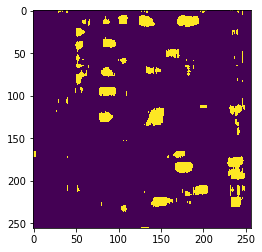

In [17]:
plt.imshow(c)

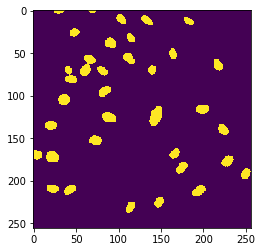

In [18]:
plt.imshow(masks[j])

In [61]:
# from sknn.mlp import MultiLayerPerceptron, Layer, Classifier

In [62]:
# ip_layer = Layer('Sigmoid', units=2)
# hidden_layer = Layer('Tanh', units=3)
# op_layer = Layer('Softmax', units=2) # <-- units=2, not 1

# mlp = Classifier(
#     [ip_layer, hidden_layer, op_layer],
#     n_iter=10000
# )

In [63]:
# mlp.fit(images,masks)

ValueError: bad input shape (670, 256)

In [49]:
from skimage.transform import resize

l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)
    
images=np.asarray(images)
masks=np.asarray(masks)

In [50]:
images=np.concatenate(images,axis=0)
masks=np.concatenate(masks,axis=0)

In [23]:
np.shape(masks)

(171520, 256)

In [24]:
l=(100,)
mlp = MLPClassifier(solver='lbfgs',hidden_layer_sizes=l,max_iter=1000)

In [83]:
#670 images 256 by 256
256*670
256*10
256*50
256*300

76800

In [32]:
images_train=images[0:2560,:] #first 10 images
masks_train=masks[0:2560,:] #masks for first 10 images
np.shape(images_train)

(2560, 256)

In [29]:
masks_train

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ..., 
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]])

In [33]:
%%time
a=mlp.fit(images_train,masks_train)

CPU times: user 5min 42s, sys: 8min 20s, total: 14min 2s
Wall time: 1min 47s


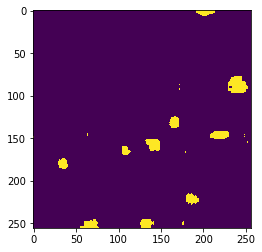

In [46]:
plt.imshow(a.predict(images[50]))

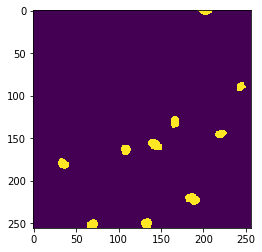

In [47]:
plt.imshow(masks[50])

In [54]:
images_train50=images[0:12800,:] #first 50 images
masks_train50=masks[0:12800,:] #masks for first 50 images

In [55]:
%%time
a1=mlp.fit(images_train50,masks_train50)

CPU times: user 15min 8s, sys: 10min 49s, total: 25min 57s
Wall time: 5min 48s


In [56]:
l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)
    
images=np.asarray(images)
masks=np.asarray(masks)

In [72]:
j=650
c=a.predict(images[j])

mlp.score(c,masks[j])

0.0

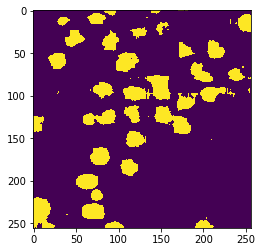

In [73]:
plt.imshow(c)

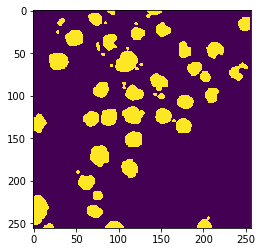

In [74]:
plt.imshow(masks[j])

In [75]:
c

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ..., 
       [0, 1, 1, ..., 0, 0, 0],
       [0, 1, 1, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0]])

In [76]:
def rle_encoding(x):
    '''
    x: numpy array of shape (height, width), 1 - mask, 0 - background
    Returns run length as list
    '''
    dots = np.where(x.T.flatten()==1)[0] # .T sets Fortran order down-then-right
    run_lengths = []
    prev = -2
    for b in dots:
        if (b>prev+1): run_lengths.extend((b+1, 0))
        run_lengths[-1] += 1
        prev = b
    return " ".join([str(i) for i in run_lengths])

In [78]:
rle_encoding(c)

'126 16 223 30 382 18 478 35 638 18 734 34 894 18 989 36 1150 17 1245 36 1406 18 1501 33 1663 17 1757 30 1919 16 2014 29 2175 7 2183 8 2270 30 2431 6 2439 8 2526 29 2686 7 2783 34 2942 8 3039 34 3199 4 3295 34 3551 34 3807 23 3831 10 4063 23 4088 9 4320 22 4344 9 4577 18 4596 1 4602 7 4664 2 4836 14 4859 6 4919 6 5092 13 5115 6 5174 9 5352 4 5371 6 5430 13 5628 5 5686 13 5884 5 5942 15 6141 4 6197 17 6397 4 6452 18 6654 2 6707 19 6963 19 7182 1 7219 19 7266 2 7436 6 7475 19 7520 3 7690 8 7732 18 7946 9 7987 19 8201 10 8243 19 8457 10 8500 17 8713 11 8756 16 8969 10 9013 14 9225 10 9269 14 9481 10 9505 5 9527 12 9737 8 9761 6 9787 6 9993 7 10017 9 10225 1 10250 5 10273 10 10480 2 10507 3 10529 10 10764 2 10784 11 11020 3 11033 18 11289 19 11544 20 11800 20 12056 19 12312 19 12568 18 12824 17 13081 16 13255 7 13337 16 13510 9 13593 15 13764 13 13852 12 14020 13 14110 10 14275 15 14366 9 14531 15 14622 9 14787 16 14829 5 14880 6 15043 16 15080 11 15137 4 15229 9 15298 17 15335 13 15394 2 

In [81]:
x=np.array([0,0,1,1,0,1,1,1])

In [82]:
rle_encoding(x)

'3 2 6 3'

In [85]:
from skimage.transform import resize

l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)
    
images=np.asarray(images)
masks=np.asarray(masks)

images=np.concatenate(images,axis=0)
masks=np.concatenate(masks,axis=0)

In [86]:
images_train300=images[0:76800,:] #first 300 images
masks_train300=masks[0:76800,:] #masks for first 300 images

In [87]:
%%time
a2=mlp.fit(images_train300,masks_train300)

CPU times: user 1h 13min 5s, sys: 22min 35s, total: 1h 35min 40s
Wall time: 32min 31s


In [91]:
l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)
    
images=np.asarray(images)
masks=np.asarray(masks)



In [99]:
j=500
c=a2.predict(images[j])

mlp.score(c,masks[j])

0.0

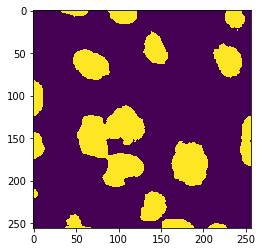

In [100]:
plt.imshow(c)

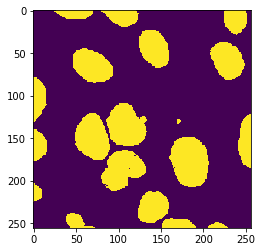

In [101]:
plt.imshow(masks[j])

In [114]:
import cv2
import pandas as pd
from scipy import ndimage

def analyze_image(im_path):
    '''
    Take an image_path (pathlib.Path object), preprocess and label it, extract the RLE strings 
    and dump it into a Pandas DataFrame.
    '''
    # Read in data and convert to grayscale
    im_id = im_path.parts[-3]
    im = cv2.imread(str(im_path),0)
    im=resize(im,(256,256))
    #im_gray = rgb2gray(im)
    
    # Mask out background and extract connected objects
    
    mask = a2.predict(im)
    if np.sum(mask==0) < np.sum(mask==1):
        mask = np.where(mask, 0, 1)    
        labels, nlabels = ndimage.label(mask)
    labels, nlabels = ndimage.label(mask)
    
    # Loop through labels and add each to a DataFrame
    im_df = pd.DataFrame()
    for label_num in range(1, nlabels+1):
        label_mask = np.where(labels == label_num, 1, 0)
        if label_mask.flatten().sum() > 10:
            rle = rle_encoding(label_mask)
            s = pd.Series({'ImageId': im_id, 'EncodedPixels': rle})
            im_df = im_df.append(s, ignore_index=True)
    
    return im_df


def analyze_list_of_images(im_path_list):
    '''
    Takes a list of image paths (pathlib.Path objects), analyzes each,
    and returns a submission-ready DataFrame.'''
    all_df = pd.DataFrame()
    for im_path in im_path_list:
        im_df = analyze_image(im_path)
        all_df = all_df.append(im_df, ignore_index=True)
    
    return all_df

In [115]:
import pathlib
import time
t0 = time.time()

testing = pathlib.Path('../input/stage1_test/').glob('*/images/*.png')
df = analyze_list_of_images(list(testing))
df.to_csv('submission300MLP.csv', index=None)

t1=time.time()
total=t1-t0
print(total)

/usr/local/lib/python2.7/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


7.24689507484


In [116]:
df

,EncodedPixels,ImageId
0,7946 2 8194 14 8450 15 8705 16 8961 17 9217 17...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
1,14602 2 14605 1 14855 7 15111 7 15366 8 15619 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
2,37124 1 37379 3 37633 6 37889 8 38145 9 38401 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
3,61441 6 61697 6 61953 7 62209 7 62465 8 62721 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
4,27163 1 27403 3 27417 4 27659 7 27672 6 27914 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
5,48921 1 49177 1 49433 1 49681 1 49686 2 49689 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
6,34329 1 34572 7 34583 4 34828 14 35084 15 3534...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
7,61720 1 61975 6 62226 12 62481 13 62737 13 629...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
8,16154 1 16410 1 16666 2 16922 2 17178 2 17434 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...
9,57112 5 57368 5 57624 5 57880 6 58136 5 58392 ...,912a679e4b9b1d1a75170254fd675b8c24b664d80ad7ea...


In [120]:
from skimage.transform import resize

l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)
    
images=np.asarray(images)
masks=np.asarray(masks)

images=np.concatenate(images,axis=0)
masks=np.concatenate(masks,axis=0)

In [121]:
%%time
a3=mlp.fit(images,masks)  #fit on all images and corresponding masks

CPU times: user 2h 34min 29s, sys: 36min 54s, total: 3h 11min 24s
Wall time: 1h 9min 34s


In [122]:
l=X.shape[0]
images=[None]*l
masks=[None]*l
for i in range(l):
    images[i]=resize(X[i][:,:,0],(256, 256), mode='constant', preserve_range=True)
    masks[i]=resize(Y[i],(256, 256), mode='constant', preserve_range=True)
    masks[i]=masks[i].astype(int)
    
images=np.asarray(images)
masks=np.asarray(masks)


In [124]:
j=500
c=a3.predict(images[j])

mlp.score(c,masks[j])

0.0

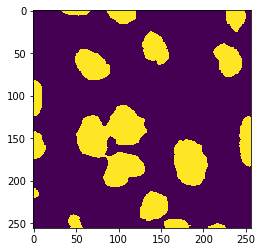

In [125]:
plt.imshow(c)

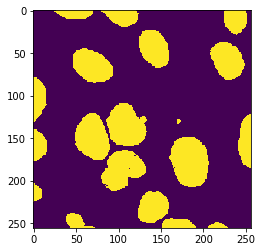

In [126]:
plt.imshow(masks[j])

In [127]:
import cv2
import pandas as pd
from scipy import ndimage

def analyze_image(im_path):
    '''
    Take an image_path (pathlib.Path object), preprocess and label it, extract the RLE strings 
    and dump it into a Pandas DataFrame.
    '''
    # Read in data and convert to grayscale
    im_id = im_path.parts[-3]
    im = cv2.imread(str(im_path),0)
    im=resize(im,(256,256))
    #im_gray = rgb2gray(im)
    
    # Mask out background and extract connected objects
    
    mask = a3.predict(im)
    if np.sum(mask==0) < np.sum(mask==1):
        mask = np.where(mask, 0, 1)    
        labels, nlabels = ndimage.label(mask)
    labels, nlabels = ndimage.label(mask)
    
    # Loop through labels and add each to a DataFrame
    im_df = pd.DataFrame()
    for label_num in range(1, nlabels+1):
        label_mask = np.where(labels == label_num, 1, 0)
        if label_mask.flatten().sum() > 10:
            rle = rle_encoding(label_mask)
            s = pd.Series({'ImageId': im_id, 'EncodedPixels': rle})
            im_df = im_df.append(s, ignore_index=True)
    
    return im_df


def analyze_list_of_images(im_path_list):
    '''
    Takes a list of image paths (pathlib.Path objects), analyzes each,
    and returns a submission-ready DataFrame.'''
    all_df = pd.DataFrame()
    for im_path in im_path_list:
        im_df = analyze_image(im_path)
        all_df = all_df.append(im_df, ignore_index=True)
    
    return all_df

In [128]:
import pathlib
import time
t0 = time.time()

testing = pathlib.Path('../input/stage1_test/').glob('*/images/*.png')
df = analyze_list_of_images(list(testing))
df.to_csv('submissionMLP.csv', index=None)

t1=time.time()
total=t1-t0
print(total)

7.33153605461


In [129]:
len(df)

2312